<a href="https://colab.research.google.com/github/saisrikanthrayavarapu/style-transfer-using-GAN/blob/master/CAPSTONE_(Style_Transfer_using_GAN).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*Misdiagnosis in medical field is a very serious issue having adverse implications on the patient. With skilled radiologists overwhelmed by volume of work, there is critical need for Artifical Intelligence to assist them in taking the right decisions.*

*Magnetic Resonance Imaging (MRI) is a key imaging technology which offers superb soft tissue contrast with different contrast mechanisms such as T1 weighted and T2 weighted. A radiologist often needs multi contrast images to arrive at the right decision but is often cost prohibitive.*

*Using CycleGAN to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs you will create T2 weighted images from T1 weighted MRI image and vice-versa.*

### <b><u>Problem statement:</u></b> To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

##### <b>T1 v T2 images</b>

- On T1 images FAT is white
- On T2 images both FAT and WATER are white

The two basic types of MRI images are T1-weighted and T2-weighted images, often referred to as T1 and T2 images.

The timing of radiofrequency pulse sequences used to make T1 images results in images which highlight fat tissue within the body.The timing of radiofrequency pulse sequences used to make T2 images results in images which highlight fat AND water within the body.

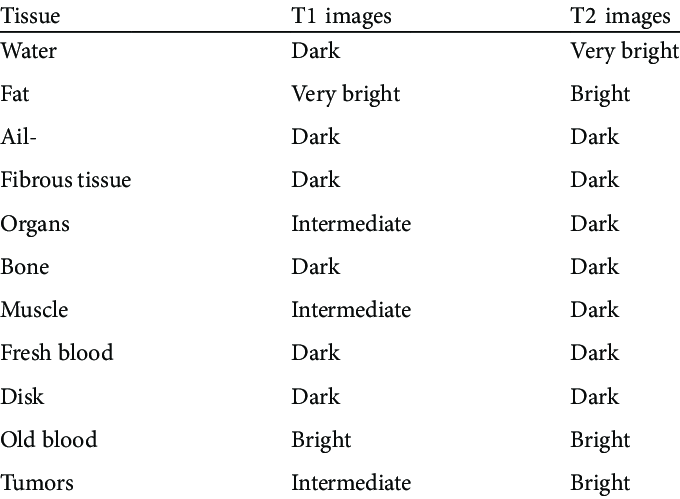

## Importing Libraries

In [ ]:
# Importing all the required libraries

import numpy as np
import tensorflow as tf
import glob
import os
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import time
import imageio
import pathlib

## **Data Loading**

In [ ]:
# mounting Google drive on colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir '/content/Style_Transfer_using_GAN' # creating a new directory that serves as root
!gdown --id '1sfCJirJGBNDMJJmOo__yRl835JS_1d8W' # downloading the data set (RAR format) in the session

# https://drive.google.com/file/d/1sfCJirJGBNDMJJmOo__yRl835JS_1d8W/view?usp=sharing

Downloading...
From: https://drive.google.com/uc?id=1sfCJirJGBNDMJJmOo__yRl835JS_1d8W
To: /content/MRI+T1_T2+Dataset.RAR
100% 1.82M/1.82M [00:00<00:00, 205MB/s]


In [ ]:
# unarchieving the dataset from the session storage and moving to the created root folder
!pip install patool  # https://pypi.org/project/patool/
import patoolib
patoolib.extract_archive('/content/MRI+T1_T2+Dataset.RAR', outdir='/content/Style_Transfer_using_GAN')

     |████████████████████████████████| 77 kB 2.4 MB/s 
patool: Extracting /content/MRI+T1_T2+Dataset.RAR ...
patool: running /usr/bin/unrar x -- /content/MRI+T1_T2+Dataset.RAR
patool:     with cwd='/content/Style_Transfer_using_GAN'
patool: ... /content/MRI+T1_T2+Dataset.RAR extracted to `/content/Style_Transfer_using_GAN'.


'/content/Style_Transfer_using_GAN'

In [ ]:
# setting path to the T1 an T2 datasets
T1_path = pathlib.Path('/content/Style_Transfer_using_GAN/Tr1/')
T2_path = pathlib.Path('/content/Style_Transfer_using_GAN/Tr2/')

In [ ]:
# verifying the image count in the dataset
T1_image_count = len(list(T1_path.glob('*/*.png'))) # all the data inside the dataset are in PNG format
T2_image_count = len(list(T2_path.glob('*/*.png')))

print('Number of images in T1 directory --> ',T1_image_count)
print('Number of images in T2 directory --> ',T2_image_count)

Number of images in T1 directory -->  43
Number of images in T2 directory -->  46


## Data understanding:
The data from the Given data set (`MRI+T1_T2+Dataset.RAR`) containing both T1 and T2 MRI images in RGB format of base size (217 x 181). Given images should be preprocessed for further analysis. 

The T1 and T2 MRI Images included in the dataset are not related in any way since we have an unpaired dataset here. Hence we would be using cycleGAN in this problem

## Image Processing:

As part of image preprocessing following steps will be performed on the data set

1. Reshape, shuffle, batch and convert the image to grayscale (returned as T1 and T2)
  
  *Reshaping the image size from base size (217 x 181) to (256 x 256) using batch size of 1* 
2. Normalize the image (data re-scaling in the range of [-1,1])
3. Data augmentation (Here performing random horizontal flip on the image)

In [ ]:
# # method to load the images from the given directory path
def data_load(directory):
  image = tf.keras.preprocessing.image_dataset_from_directory(directory, 
                                                    labels='inferred', 
                                                    label_mode='int', 
                                                    class_names=None, 
                                                    color_mode='grayscale', 
                                                    batch_size=1, 
                                                    image_size=(256, 256), 
                                                    shuffle= True, 
                                                    seed=42, 
                                                    validation_split=None, 
                                                    subset=None, 
                                                    interpolation='bilinear', 
                                                    follow_links=False)
  return image

In [ ]:
# performing image load from directory, reshape, shuffle, batch and convert to grayscale (preprocessing-1)
T1 = data_load(T1_path)
T2 = data_load(T2_path)

Found 43 files belonging to 1 classes.
Found 46 files belonging to 1 classes.


In [ ]:
# method to normalize single channel image (preprocessing-2)
def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image - 127.5) /127.5
  return image

In [ ]:
# perform random horizontal flip and normalize the image (preprocessing-3)
def preprocess_image_train(image, label):
  image = tf.image.random_flip_left_right(image)
  image = normalize(image)
  return image

In [ ]:
# preprocessing the data under T1 and T2
T1 = T1.map(preprocess_image_train)
T2 = T2.map(preprocess_image_train)

In [ ]:
# printing the tensor specifications for the preprocessed images
print(T1)
print(T2)

<MapDataset element_spec=TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None)>
<MapDataset element_spec=TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None)>


##### Input pipeline is obtained

In [ ]:
# iterating through all the preprocessed images and caching them
sample_T1 = next(iter(T1))
sample_T2 = next(iter(T2))

### Visualization of preprocessed Images

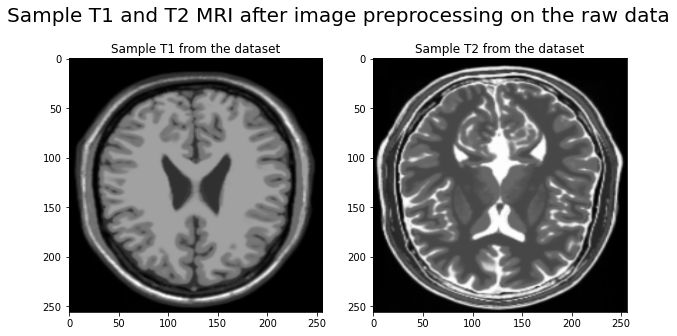

In [ ]:
# visualizing preprocessed T1 and T2 from the input dataset
f, ax = plt.subplots(1,2, figsize=(10,10))
f.suptitle('Sample T1 and T2 MRI after image preprocessing on the raw data', fontsize=20, y=0.75)
ax[0].set_title('Sample T1 from the dataset')
ax[0].imshow(sample_T1[0].numpy()[:, :, 0], cmap = 'gray')
ax[1].set_title('Sample T2 from the dataset')
ax[1].imshow(sample_T2[0].numpy()[:, :, 0], cmap = 'gray')
plt.show()

## Model-Building:

Following steps are performed in the Model building process

 - Instance Normalization
 - Generator Design using U-net archictecture (using encoder and decoder stacks that helps in localizing the abnormality)
 - Descriminator Design



### Instance Normalization

Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

In [ ]:
# downloading keras_contrib library
!pip install git+https://www.github.com/keras-team/keras-contrib.git --quiet

In [ ]:
# creating Instance Normalization layer
from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization
InstanceNormalization(axis=-1)

In [ ]:
# generates normal distributed tensors (noise) with given mean and standard deviation
initializer = tf.initializers.RandomNormal(mean=0.0, stddev=0.02, seed=None) 

### Downsample
model convolution is applied to reduce the image size and increase image depth (encoder)


In [ ]:
# method to downsample images using convolution, downsamples the image dimensions
def downsample(filters, size, apply_norm=True):
  result = tf.keras.Sequential() # adding a sequential layer
  # adding a 2D convolution layer of defined filter and size to the sequential layer
  result.add(tf.keras.layers.Conv2D(filters, 
                                      size, 
                                      strides=2, 
                                      padding='same',
                                      kernel_initializer=initializer, 
                                      use_bias=False))
  if apply_norm:
    result.add(InstanceNormalization()) # batch normalization
  result.add(tf.keras.layers.PReLU()) # activation
  return result

### Upsample
transposed convolution is applied which increases the image size (decoder)

In [ ]:
# method to upsample the downsampled images connected to a transformer block, upsamples the image dimension
def upsample(filters, size, apply_dropout=False):
  result = tf.keras.Sequential() # adding a sequential layer
  # adding a 2D convolution transpose layer of defined filter and size to the sequential layer
  result.add(tf.keras.layers.Conv2DTranspose(filters, 
                                              size, 
                                              strides=2, 
                                              padding='same',
                                              kernel_initializer=initializer, 
                                              use_bias=False))
  result.add(InstanceNormalization())
  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5)) # dropout
  result.add(tf.keras.layers.ReLU()) # activation
  return result

### Generator

Generator follows *U-net architecture* which is fairly simple architecture; however, to create the skip connections between the encoder and decoder, we will need to concatenate some layers. So the Keras Functional API is most appropriate for this purpose.

U-Net is able to localize and distinguish borders by classifying on every pixel, with both input and output images being of same size

Here, Generator generates synthetic images(T1 to T2 and vice versa) using given random normal initializer 

In [ ]:
# building U-net generator
def unet_generator():
  inputs = tf.keras.layers.Input(shape=[256,256,1]) # input layer
  # increasing the image size from (256 x 256 x 1) --> (1 x 1 x 512)
  down_stack = [
      downsample(128, 4, apply_norm=False), 
      downsample(256, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
    ]
  # decreasing the image size from (1 x 1 x 512) --> (128 x 128 x 256)
  up_stack = [
      upsample(512, 4, apply_dropout=True),
      upsample(512, 4, apply_dropout=True), 
      upsample(512, 4, apply_dropout=True), 
      upsample(512, 4), 
      upsample(512, 4), 
      upsample(256, 4), 
      upsample(128, 4),
    ]
  # (125 x 128 x 256) --> (256 x 256 x 1)
  last = tf.keras.layers.Conv2DTranspose(1, 4,
                                          strides=2,
                                          padding='same',
                                          kernel_initializer=initializer,
                                          activation='tanh') 

  x = inputs
  # skip connections is used to concatenate encoder with decoder
  skips = []
  # downsampling
  for down in down_stack:
    x = down(x)
    skips.append(x)
  skips = reversed(skips[:-1])
  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])
  x = last(x)
  return tf.keras.Model(inputs=inputs, outputs=x) # returns U-net generator model

To summarize the U-net generator the input image (256 x 256 x 1) is increased to (1 x 1 x 512) and brought back to (256 x 256 x 1) using encoder [which learns the image irrespective of its loaction] and decoder [details are captured here] using skip connections to get precise locations, feature maps from corresponding encoder level is concatenated with output of transposed convolutional layers

In [ ]:
# initializing the generator
generator_g = unet_generator() # T1 images will transform to T2
generator_f = unet_generator() # T2 images will transform to T1

generator_g learns to transform image from T1 to T2

generator_f learns to transform image from T2 to T1

In [ ]:
# summarizing U-net Generator
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 12  2099200     ['input_1[0][0]']                
                                8)                                                                
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 256)  1572866     ['sequential[0][0]']             
                                                                                              

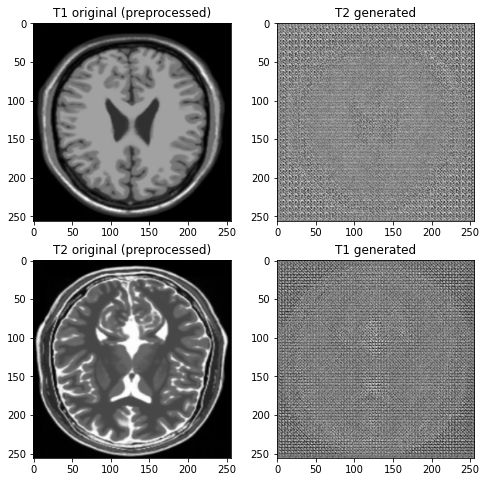

In [ ]:
# plotting the original and generated images using created Generator

to_T2 = generator_g(sample_T1)
to_T1 = generator_f(sample_T2)
img_array = [sample_T1, to_T2, sample_T2, to_T1]
img_title = ['T1 original (preprocessed)', 'T2 generated', 'T2 original (preprocessed)', 'T1 generated']

f, ax = plt.subplots(2, 2, figsize=(8,8))
ax[0,0].set_title(img_title[0])
ax[0,0].imshow(img_array[0][0].numpy()[:, :, 0], cmap='gray')
ax[0,1].set_title(img_title[1])
ax[0,1].imshow(img_array[1][0].numpy()[:, :, 0], cmap='gray')
ax[1,0].set_title(img_title[2])
ax[1,0].imshow(img_array[2][0].numpy()[:, :, 0], cmap='gray')
ax[1,1].set_title(img_title[3])
ax[1,1].imshow(img_array[3][0].numpy()[:, :, 0], cmap='gray')
plt.show()

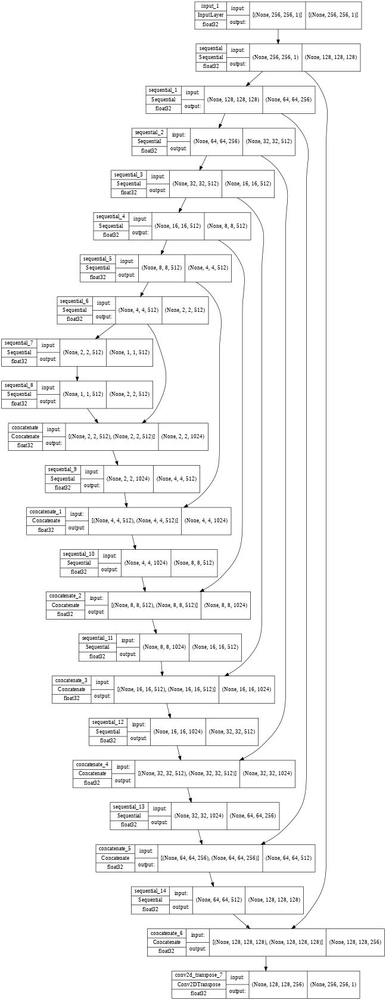

In [ ]:
# visualizing the U-net model(generator) using plot_model
# explains the transformations iccured in U-net generator
tf.keras.utils.plot_model(
    generator_g,
    to_file="unet_generator_model.png",
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=48)

### Discriminator
Discriminator is a traditional CNN, which we use to classify the Images. It only uses Downsampling hence. Discriminator shall classify a portion of the image generated from the generator (input image) as fake or real

In [ ]:
# building the discriminator
def discriminator():
  # inputlayer
  inputs = tf.keras.layers.Input(shape=[256,256, 1], name='input_image')
  x = inputs

  # add downsampling step here
  down1 = downsample(128, 4, False)(x) 
  down2 = downsample(256, 4)(down1) 
  down3 = downsample(512, 4)(down2) 
  
  # add a padding layer here
  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) 
  conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) 
  norm1 = InstanceNormalization()(conv)
  leaky_relu = tf.keras.layers.PReLU()(norm1)

  # apply zero padding layer
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) 
  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) 
  return tf.keras.Model(inputs=[inputs], outputs=last) 

Discriminator uses an image patch of (30 x 30 x 1) from the generator to verify the synthetic image as real or fake

In [ ]:
# Initializing the discriminators
discriminator_x = discriminator() # separates real T1 from generated T1
discriminator_y = discriminator() # separates real T2 from generated T2

discriminator_x learns to differentiate between image T1 and generated image T1.

discriminator_y learns to differentiate between image T2 and generated image T2

In [ ]:
# summarizing the discriminator
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 256, 256, 1)]     0         
                                                                 
 sequential_30 (Sequential)  (None, 128, 128, 128)     2099200   
                                                                 
 sequential_31 (Sequential)  (None, 64, 64, 256)       1572866   
                                                                 
 sequential_32 (Sequential)  (None, 32, 32, 512)       2621442   
                                                                 
 zero_padding2d (ZeroPadding  (None, 34, 34, 512)      0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 31, 31, 512)       4194304   
                                                           

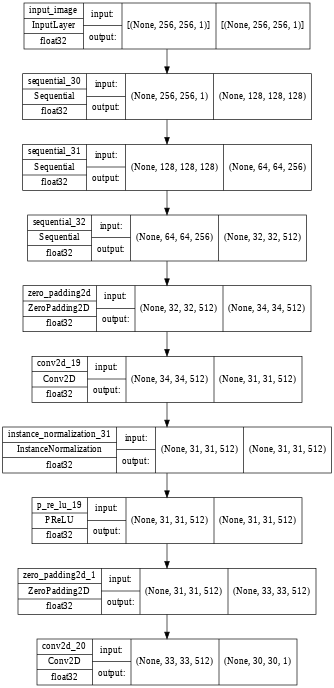

In [ ]:
# visualising the created Discriminator model using plot_model
tf.keras.utils.plot_model(
    discriminator_x,
    to_file="discriminator_model.png",
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=48)

## Model Training:

The training consists of four broad steps

1. Get the predictions — The generator and discriminator modules are used to get the predictions
2. Calculate the loss — Various loss functions defined above are used to calculate the losses
3. Calculate the gradients using backpropagation
4. Apply the gradients to the optimizer — Adam optimizer as defined in the original paper is used for optimization

#### 1. Discriminator loss

It consists of 2 parts
 - i. loss function of real images which is a binary cross entropy loss and ones arrays `real_loss`
 - ii. loss from generated (fake) images which is a binary cross entropy loss of generated images and zero arrays   `generated_loss`

Now the `total_loss` (discriminator loss) is a sum of real_loss and generated_loss


In [ ]:
# declaring the loss function (using BinaryCrossentropy since our discriminator is a classifier)
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
# Discriminator adversarial loss

def discriminator_loss(real, generated):
  real_loss = loss_fn(tf.ones_like(real), real)
  generated_loss = loss_fn(tf.zeros_like(generated), generated)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss * 0.5

#### 2. Generator loss

It is a binary cross entropy loss of the generated images and an array of ones

In [ ]:
# method to obtain generator loss
def generator_loss(generated):
  return loss_fn(tf.ones_like(generated), generated)

#### 3. Cycle consistency loss

When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle consistency Loss.

It is the reduced mean of differnce between real and generated image. Supposedly if the generated image is translated back it should be close to original image

In [ ]:
LAMBDA = 10 # learning rate

# method to calculate cycle consitency loss
def cycle_consistency_loss(real_image, cycled_image):
  cyc_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
  return LAMBDA * cyc_loss

#### 4. Identity loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

The generated image from real image should be close to real image. The loss is between real and same image

In [ ]:
# method to calculate identity loss
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

#### Optimizer
Adam optimizer is used in both generator and discriminator outputs

In [ ]:
# beta_1: The exponential decay rate for the 1st moment estimates. Defaults to 0.9. We are taking it as 0.5 to further smoothen the training process
# beta_2: The exponential decay rate for the 2nd moment estimates. Defaults to 0.999.

generator_g_optimizer = tf.keras.optimizers.Adam(0.001, beta_1=0.5,beta_2=0.999)
generator_f_optimizer = tf.keras.optimizers.Adam(0.001, beta_1=0.5,beta_2=0.999)

discriminator_x_optimizer = tf.keras.optimizers.Adam(0.001, beta_1=0.5,beta_2=0.999)
discriminator_y_optimizer = tf.keras.optimizers.Adam(0.001, beta_1=0.5,beta_2=0.999)

#### Checkpoint - object which periodically writes checkpoints to disk.

CheckpointManager helps in managing multiple checkpoints



In [ ]:
# number of epochs for the model to be trained
EPOCHS = 90

In [ ]:
checkpoint_path =  '/content/MRI_T1_T2_checkpoints' # path to store checkpoints

checkpoint = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if checkpoint_manager.latest_checkpoint:
  checkpoint.restore(checkpoint_manager.latest_checkpoint)
  print('LATEST CHECKPOINT')

In [ ]:
# visualizes the input and synthetic images for both T1 and T2 images
def generate_images(model1, test_input1, model2, test_input2):
  prediction1 = model1(test_input1) # Image Translation from T1 to T2
  prediction2 = model2(test_input2) # Image Translation from T2 to T1
  plt.figure(figsize=(12, 8))
  display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
  title = ['Input Image (T1)', 'Synthetic Image (T2 from T1 input)', 'Input Image (T2)', 'Synthetic Image (T1 from T2 input)']
  for i in range(4):
    plt.subplot(1, 4, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [ ]:
# training step function
@tf.function # decorator function to convert given python code to portable Tensor model
def train_step(real_x, real_y):
  with tf.GradientTape(persistent=True) as tape:
    fake_y = generator_g(real_x, training=True) # synthetic T2 from input T1
    cycled_x = generator_f(fake_y, training=True) # T1 from synthetic T2

    fake_x = generator_f(real_y, training=True) # synthetic T1 from input T2
    cycled_y = generator_g(fake_x, training=True) # T2 from synthetic T1

    same_x = generator_f(real_x, training=True) # same T1 from input T1
    same_y = generator_g(real_y, training=True) # same T2 from input T2

    disc_real_x = discriminator_x(real_x, training=True) # patch from T1 input
    disc_real_y = discriminator_y(real_y, training=True) # patch from T2 input

    disc_fake_x = discriminator_x(fake_x, training=True) # patch from T1 synthetic
    disc_fake_y = discriminator_y(fake_y, training=True) # patch from T2 synthetic

    # generator loss
    gen_g_loss = generator_loss(disc_fake_y) # loss from T2 synthetic image
    gen_f_loss = generator_loss(disc_fake_x) # loss from T1 synthetic image

    # loss between input image nad cucled image
    total_cycle_loss = cycle_consistency_loss(real_x, cycled_x) + cycle_consistency_loss(real_y, cycled_y)

    # Total generator loss = adversarial loss + cycle loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    # loss between input and synthetic image patches of size (30 x 30)
    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
    
  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables) 
  discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables) 
  
  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients,generator_g.trainable_variables))
  generator_f_optimizer.apply_gradients(zip(generator_f_gradients,generator_f.trainable_variables))
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,discriminator_x.trainable_variables))
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,discriminator_y.trainable_variables))

In [ ]:
# method to save finalized model trained and evaluated for further use
def final_model_save(epoch, generator_g, generator_f):
  model_save_path = '/content/model_save/'
  T1_to_T2_model = model_save_path + 'T1_to_T2_final_model.h5'
  generator_g.save(T1_to_T2_model)
  T2_to_T1_model = model_save_path + 'T2_to_T1_final_model.h5'
  generator_f.save(T2_to_T1_model)
  print('trained models saved at %06d' % (epoch+1))

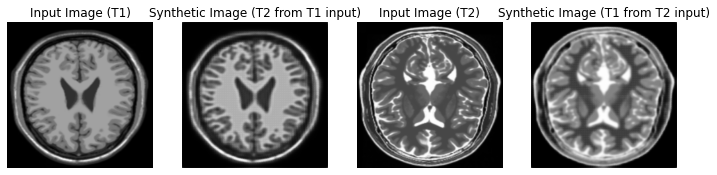

Time taken in 67 seconds for epoch 1



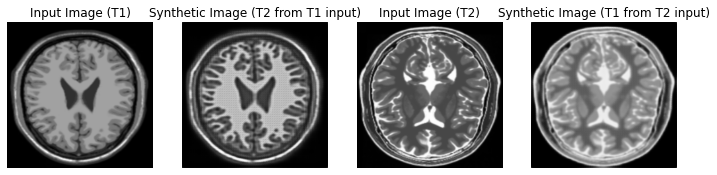

Time taken in 29 seconds for epoch 2



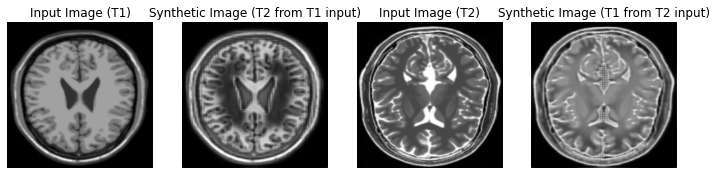

Time taken in 30 seconds for epoch 3



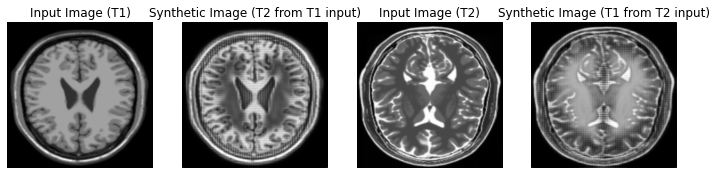

Time taken in 30 seconds for epoch 4



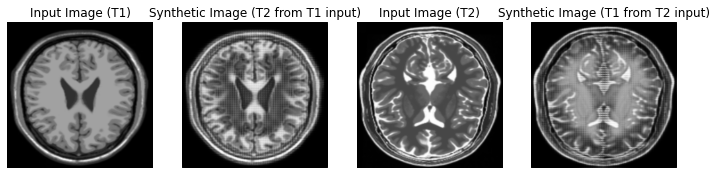

Time taken in 30 seconds for epoch 5



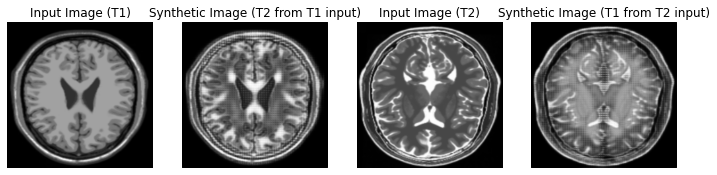

Time taken in 31 seconds for epoch 6



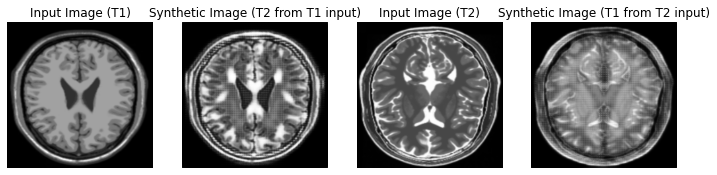

Time taken in 31 seconds for epoch 7



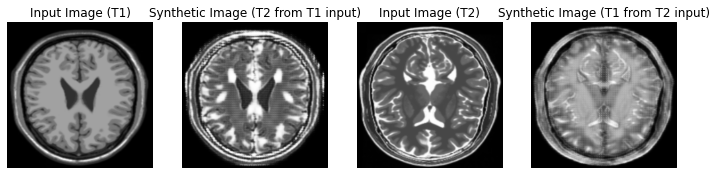

Time taken in 31 seconds for epoch 8



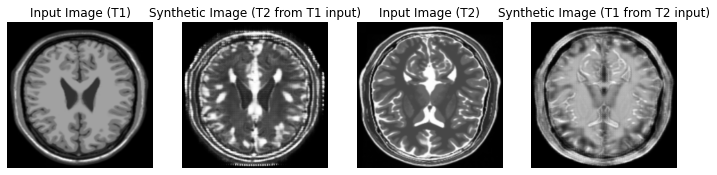

Time taken in 31 seconds for epoch 9



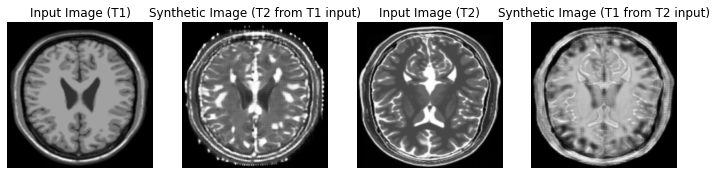

Checkpoint resored for epoch 10 at /content/MRI_T1_T2_checkpoints/ckpt-1
Time taken in 40 seconds for epoch 10



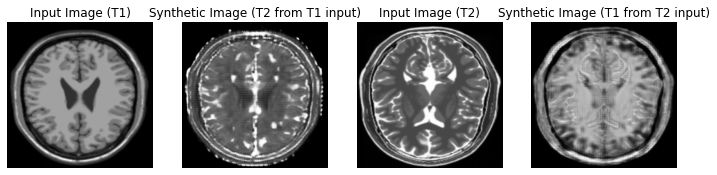

Time taken in 31 seconds for epoch 11



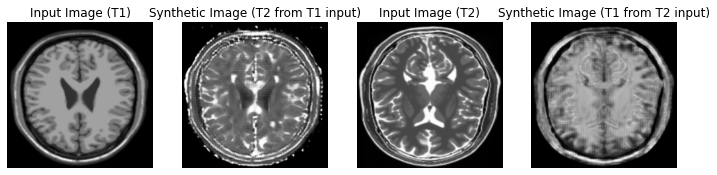

Time taken in 31 seconds for epoch 12



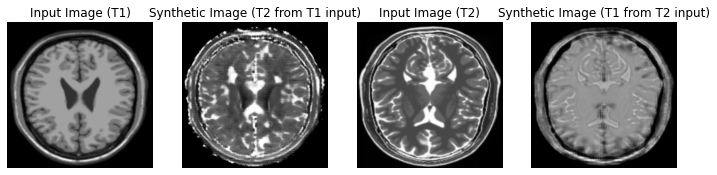

Time taken in 31 seconds for epoch 13



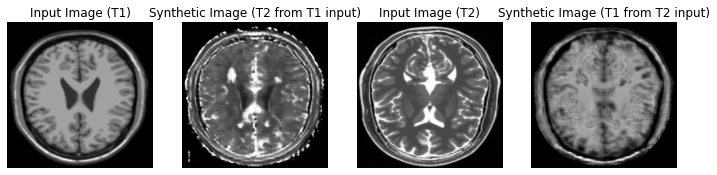

Time taken in 31 seconds for epoch 14



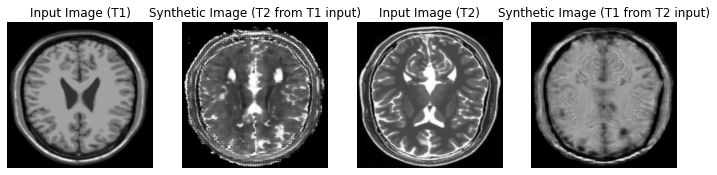

Time taken in 31 seconds for epoch 15



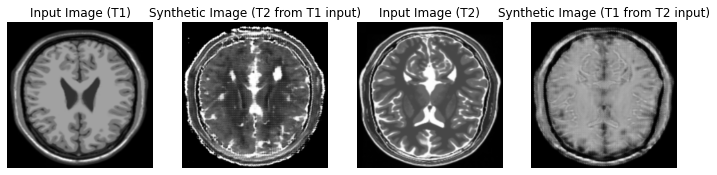

Time taken in 31 seconds for epoch 16



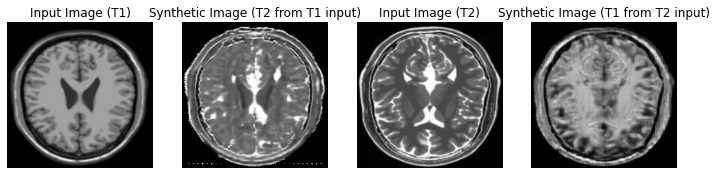

Time taken in 31 seconds for epoch 17



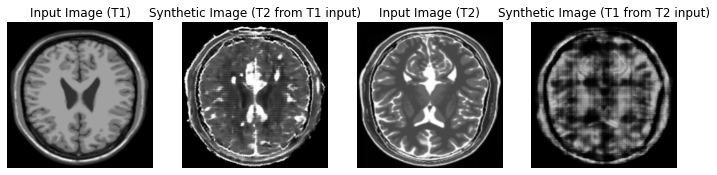

Time taken in 31 seconds for epoch 18



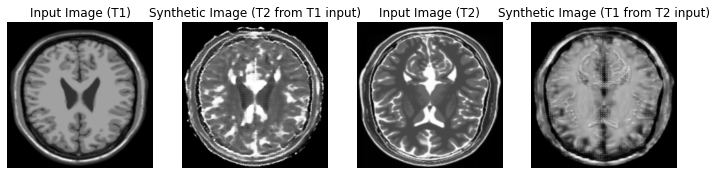

Time taken in 31 seconds for epoch 19



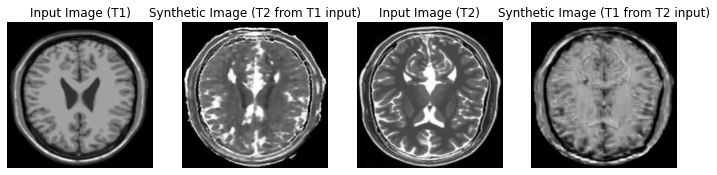

Checkpoint resored for epoch 20 at /content/MRI_T1_T2_checkpoints/ckpt-2
Time taken in 39 seconds for epoch 20



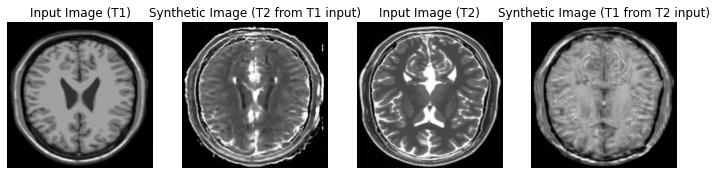

Time taken in 31 seconds for epoch 21



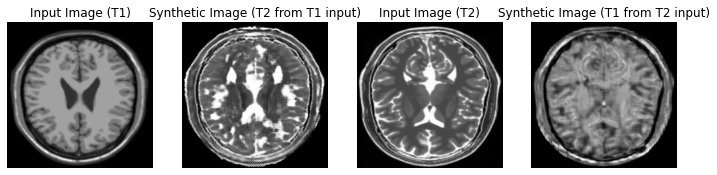

Time taken in 31 seconds for epoch 22



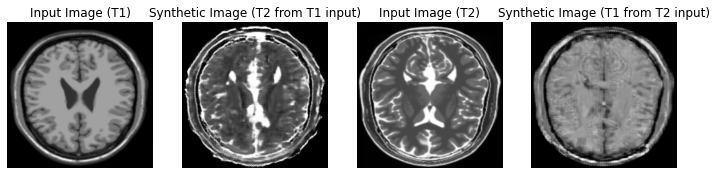

Time taken in 31 seconds for epoch 23



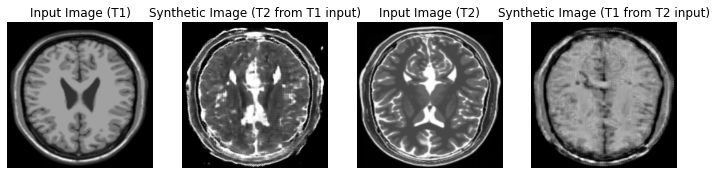

Time taken in 31 seconds for epoch 24



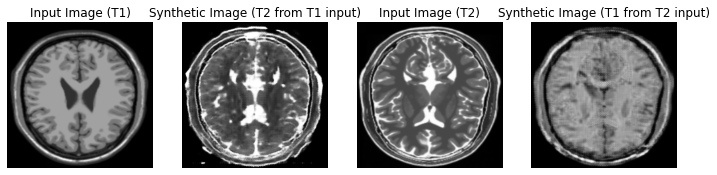

Time taken in 31 seconds for epoch 25



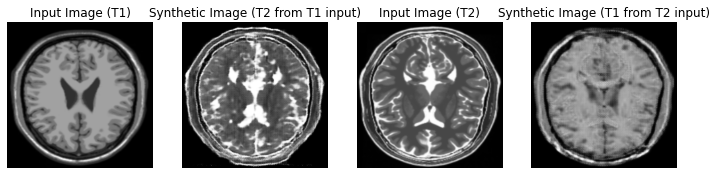

Time taken in 31 seconds for epoch 26



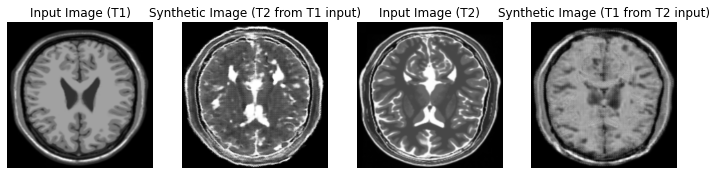

Time taken in 31 seconds for epoch 27



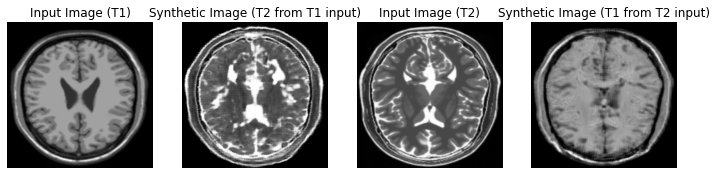

Time taken in 31 seconds for epoch 28



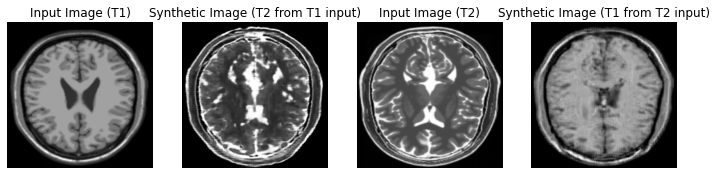

Time taken in 31 seconds for epoch 29



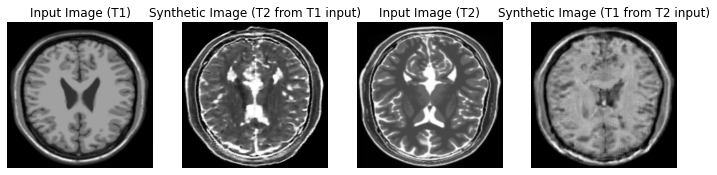

Checkpoint resored for epoch 30 at /content/MRI_T1_T2_checkpoints/ckpt-3
Time taken in 39 seconds for epoch 30



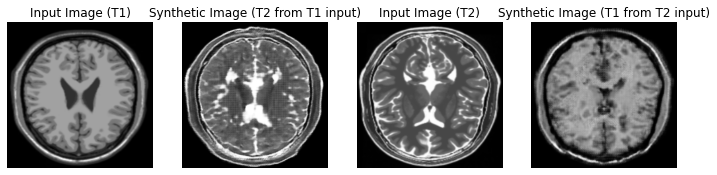

Time taken in 31 seconds for epoch 31



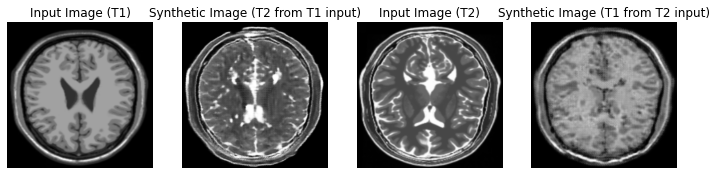

Time taken in 31 seconds for epoch 32



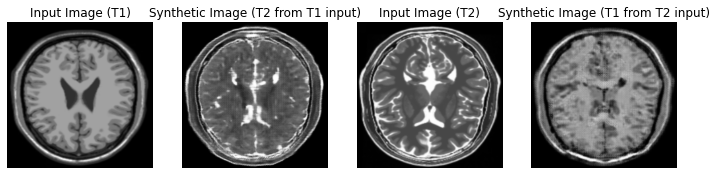

Time taken in 31 seconds for epoch 33



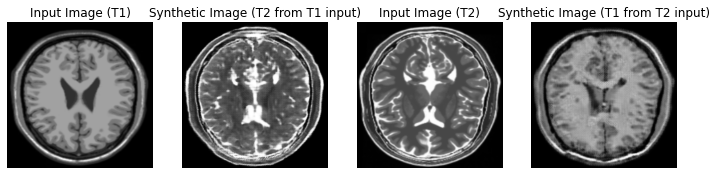

Time taken in 31 seconds for epoch 34



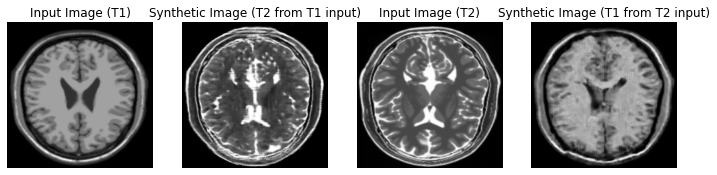

Time taken in 31 seconds for epoch 35



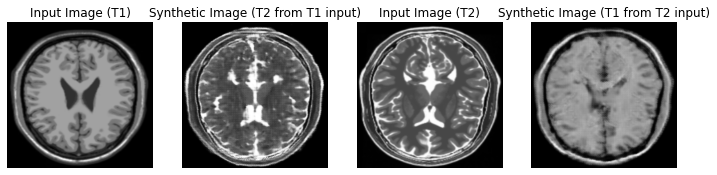

Time taken in 31 seconds for epoch 36



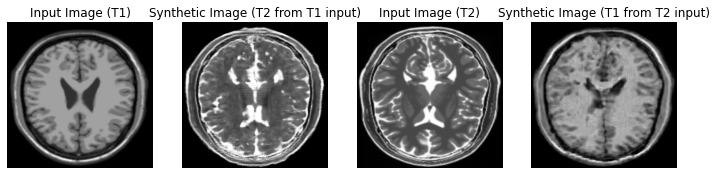

Time taken in 31 seconds for epoch 37



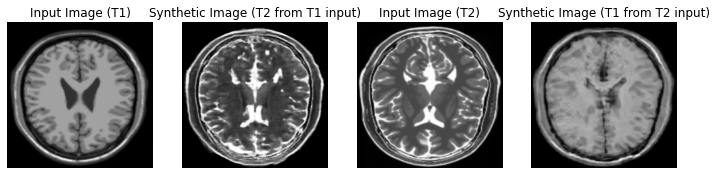

Time taken in 31 seconds for epoch 38



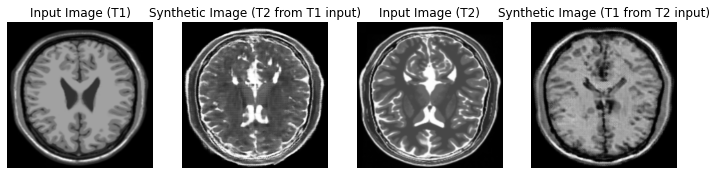

Time taken in 31 seconds for epoch 39



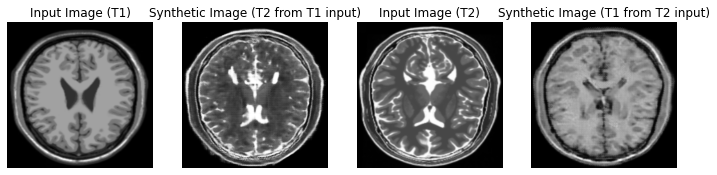

Checkpoint resored for epoch 40 at /content/MRI_T1_T2_checkpoints/ckpt-4
Time taken in 39 seconds for epoch 40



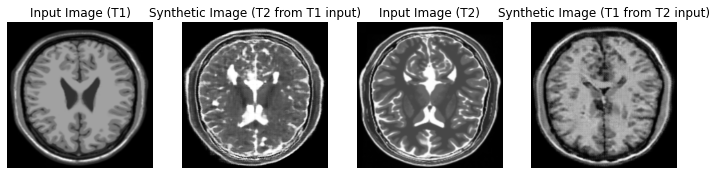

Time taken in 31 seconds for epoch 41



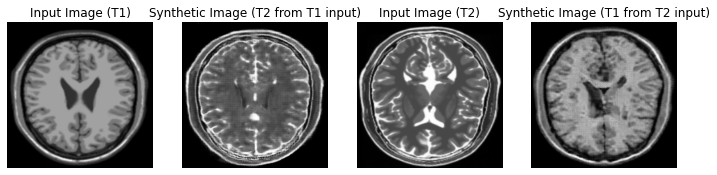

Time taken in 31 seconds for epoch 42



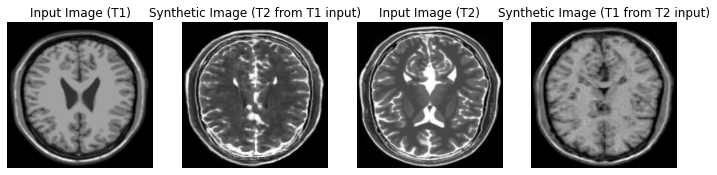

Time taken in 31 seconds for epoch 43



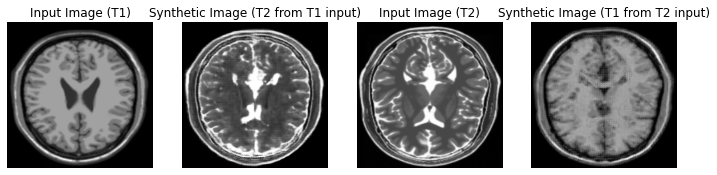

Time taken in 31 seconds for epoch 44



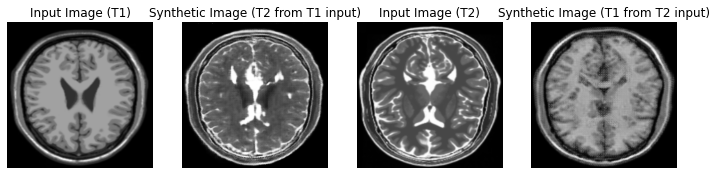

Time taken in 31 seconds for epoch 45



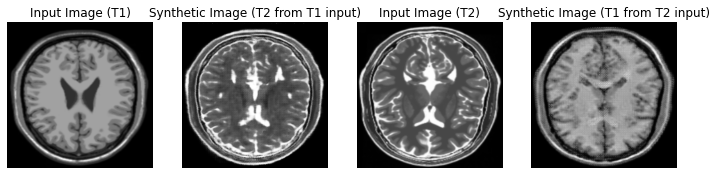

Time taken in 31 seconds for epoch 46



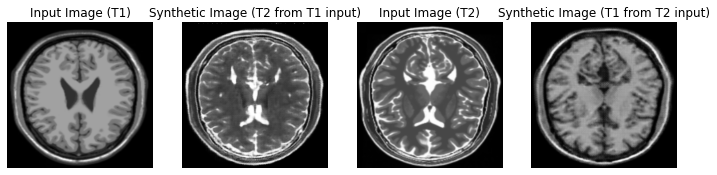

Time taken in 31 seconds for epoch 47



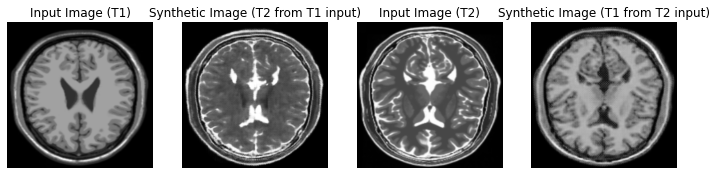

Time taken in 31 seconds for epoch 48



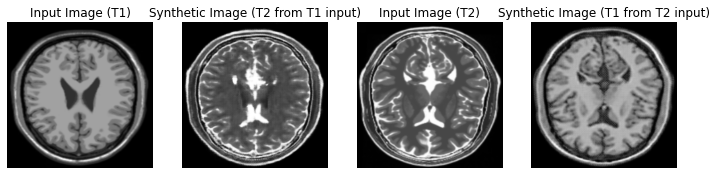

Time taken in 31 seconds for epoch 49



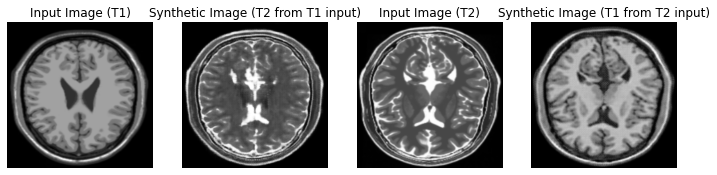

Checkpoint resored for epoch 50 at /content/MRI_T1_T2_checkpoints/ckpt-5
Time taken in 39 seconds for epoch 50



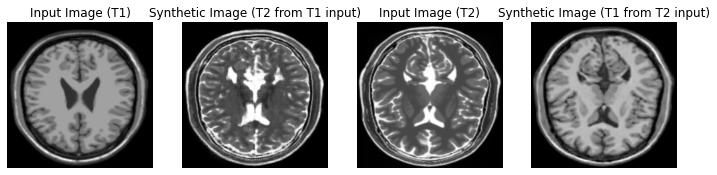

Time taken in 31 seconds for epoch 51



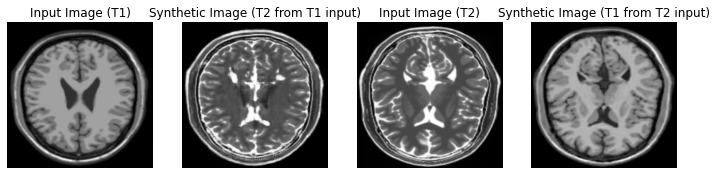

Time taken in 31 seconds for epoch 52



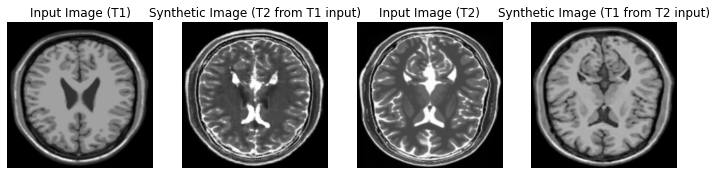

Time taken in 31 seconds for epoch 53



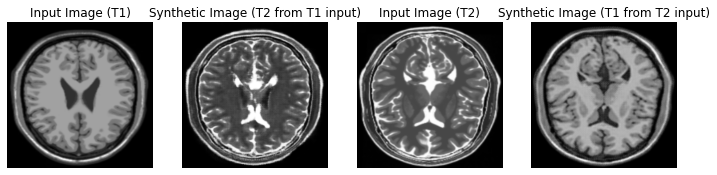

Time taken in 31 seconds for epoch 54



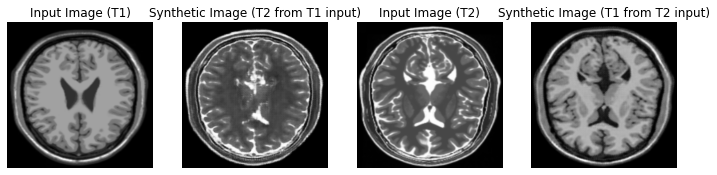

Time taken in 31 seconds for epoch 55



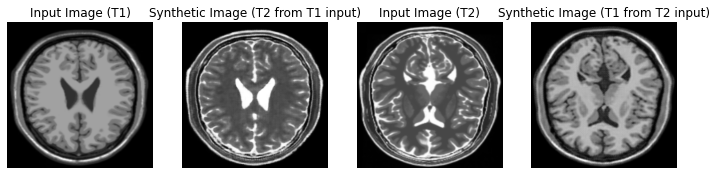

Time taken in 31 seconds for epoch 56



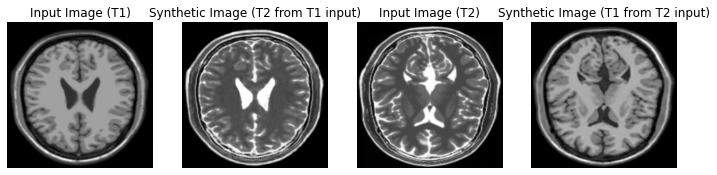

Time taken in 31 seconds for epoch 57



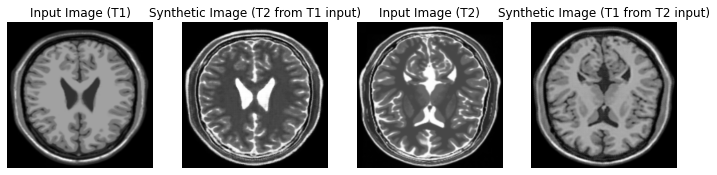

Time taken in 31 seconds for epoch 58



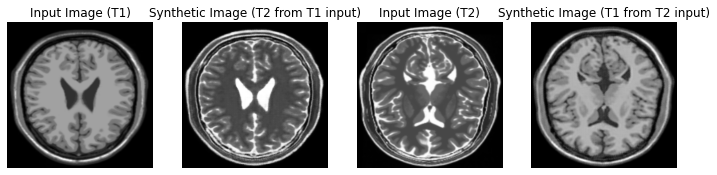

Time taken in 31 seconds for epoch 59



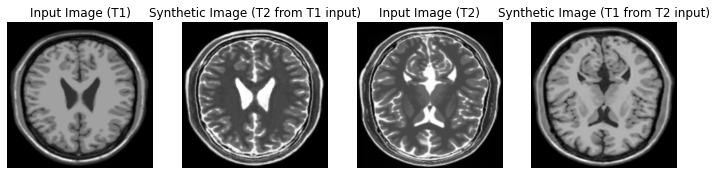

Checkpoint resored for epoch 60 at /content/MRI_T1_T2_checkpoints/ckpt-6
Time taken in 39 seconds for epoch 60



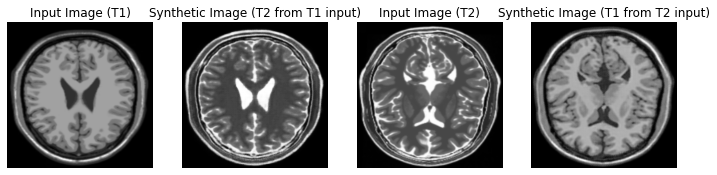

Time taken in 31 seconds for epoch 61



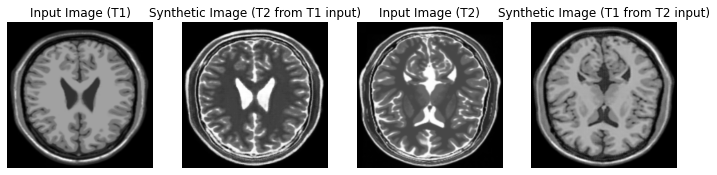

Time taken in 31 seconds for epoch 62



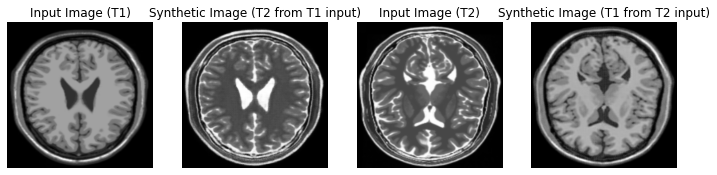

Time taken in 31 seconds for epoch 63



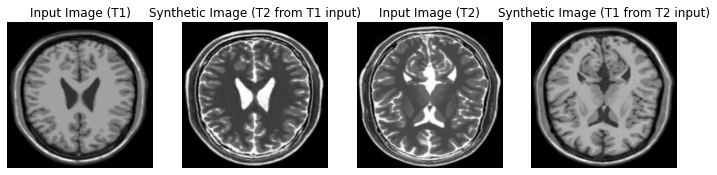

Time taken in 31 seconds for epoch 64



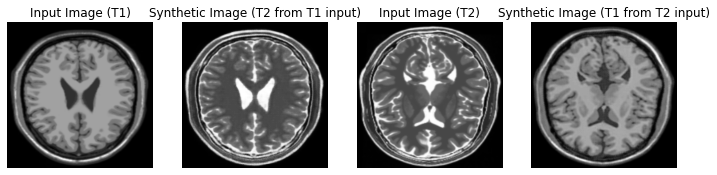

Time taken in 31 seconds for epoch 65



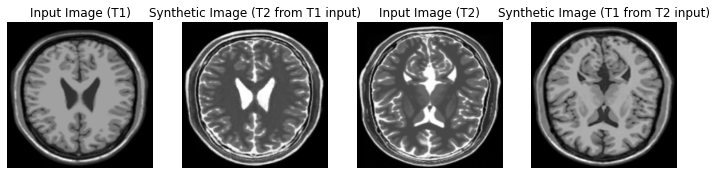

Time taken in 31 seconds for epoch 66



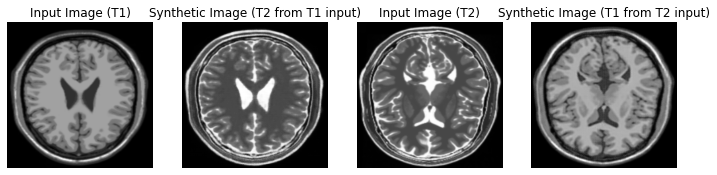

Time taken in 31 seconds for epoch 67



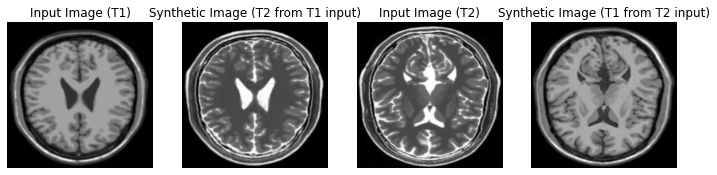

Time taken in 31 seconds for epoch 68



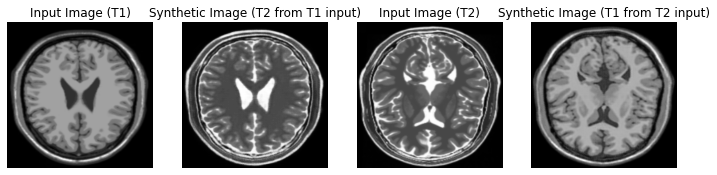

Time taken in 31 seconds for epoch 69



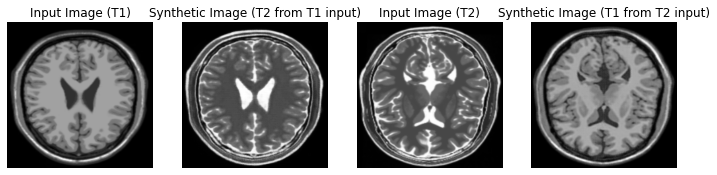

Checkpoint resored for epoch 70 at /content/MRI_T1_T2_checkpoints/ckpt-7
Time taken in 39 seconds for epoch 70



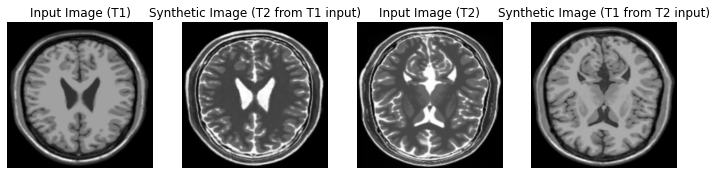

Time taken in 31 seconds for epoch 71



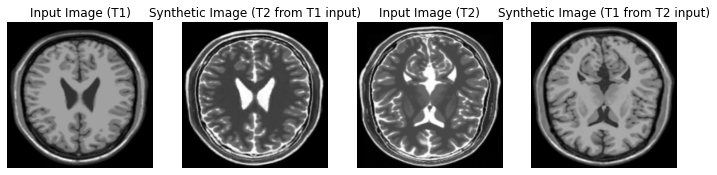

Time taken in 31 seconds for epoch 72



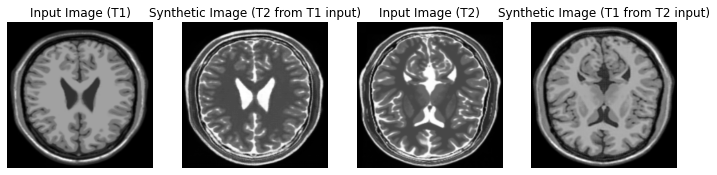

Time taken in 31 seconds for epoch 73



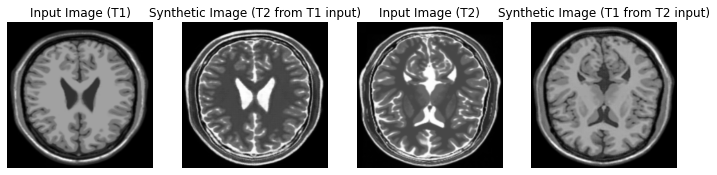

Time taken in 31 seconds for epoch 74



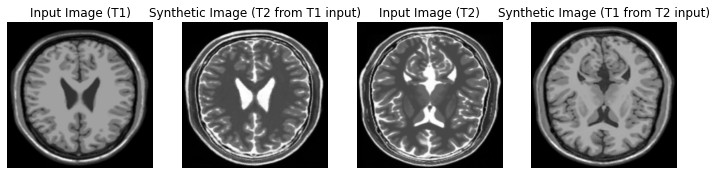

Time taken in 31 seconds for epoch 75



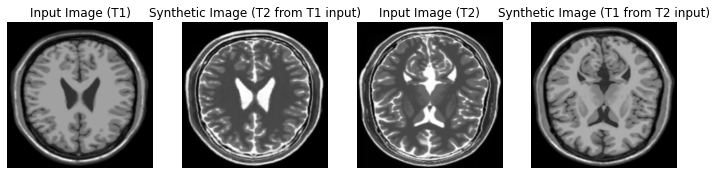

Time taken in 31 seconds for epoch 76



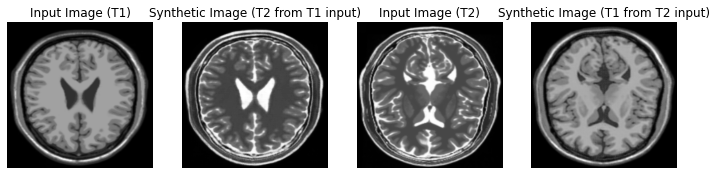

Time taken in 31 seconds for epoch 77



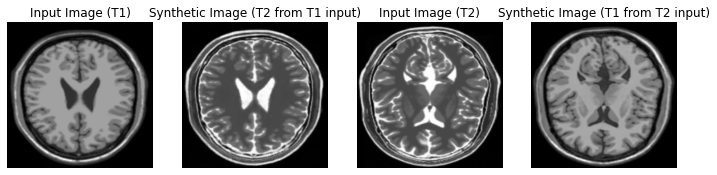

Time taken in 31 seconds for epoch 78



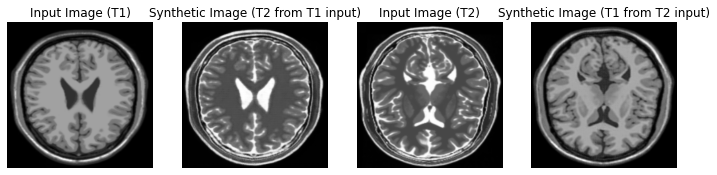

Time taken in 31 seconds for epoch 79



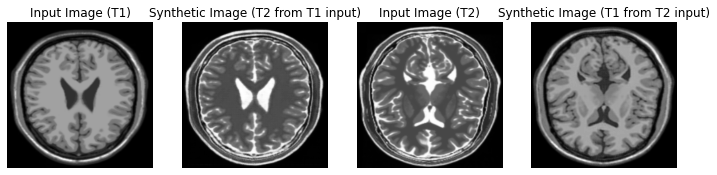

Checkpoint resored for epoch 80 at /content/MRI_T1_T2_checkpoints/ckpt-8
Time taken in 39 seconds for epoch 80



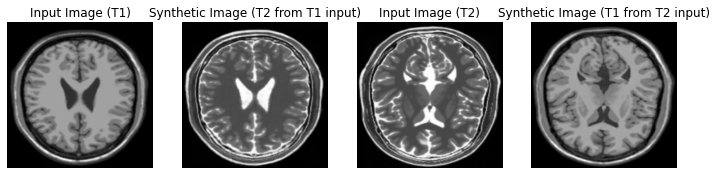

Time taken in 31 seconds for epoch 81



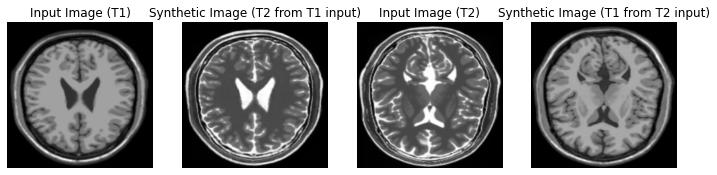

Time taken in 31 seconds for epoch 82



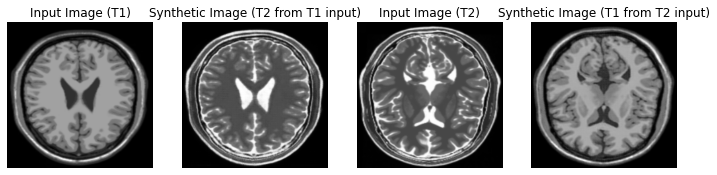

Time taken in 31 seconds for epoch 83



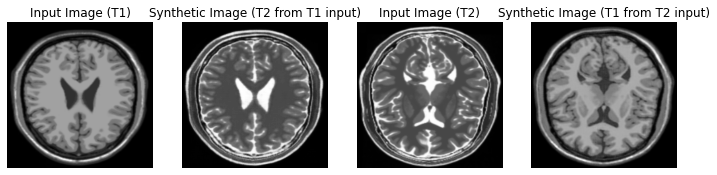

Time taken in 31 seconds for epoch 84



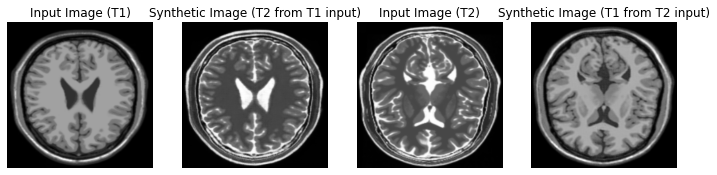

Time taken in 31 seconds for epoch 85



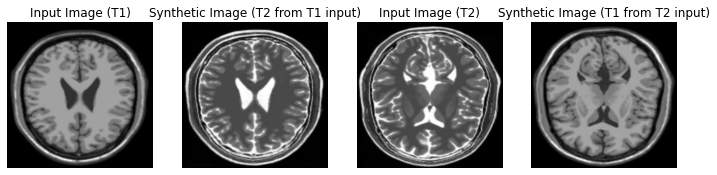

Time taken in 31 seconds for epoch 86



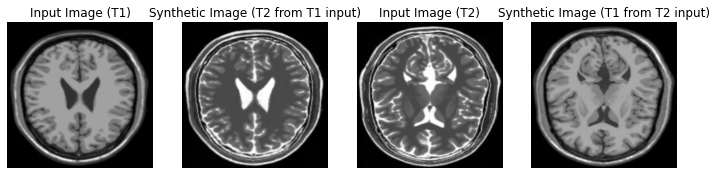

Time taken in 31 seconds for epoch 87



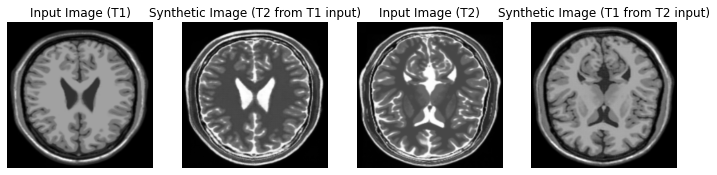

Time taken in 31 seconds for epoch 88



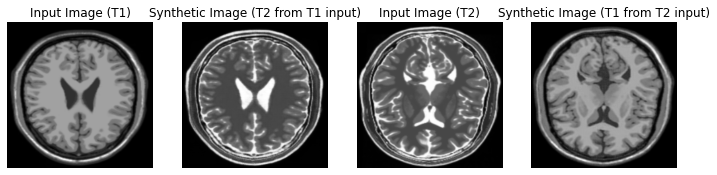

Time taken in 31 seconds for epoch 89



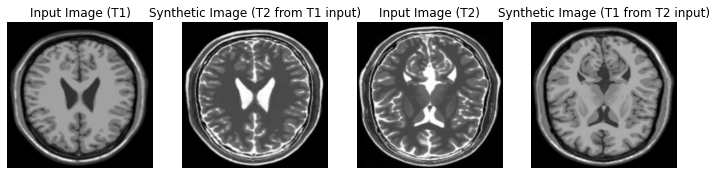

Checkpoint resored for epoch 90 at /content/MRI_T1_T2_checkpoints/ckpt-9
trained models saved at 000090
Time taken in 41 seconds for epoch 90



In [ ]:
# training the model
for epoch in range(EPOCHS):
  start = time.time() 
  for image_x, image_y in tf.data.Dataset.zip((T1, T2)): # preprocessed input
    train_step(image_x, image_y)
  if (epoch + 1) % 1 == 0:
    generate_images(generator_g, sample_T1, generator_f, sample_T2) # generates input and syntetic images
  if (epoch + 1) % 10 == 0:
    checkpoint_save_path = checkpoint_manager.save() # checkpoint saved for every 10 epochs in the given path
    print('Checkpoint restored for epoch {} at {}'.format(epoch+1, checkpoint_save_path))
  if (epoch + 1) == EPOCHS:
    final_model_save(epoch, generator_g, generator_f) # the last model is saved n the given path for further use
  print('Time taken in {} seconds for epoch {}\n'.format(round(time.time()-start),epoch + 1))

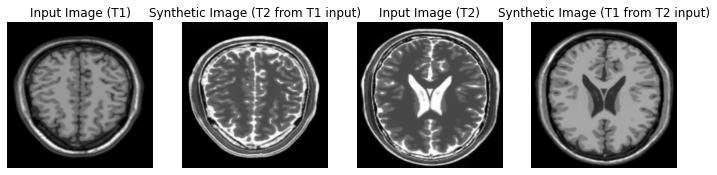

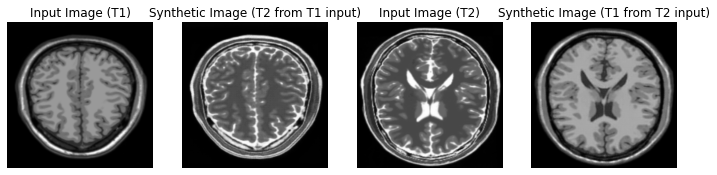

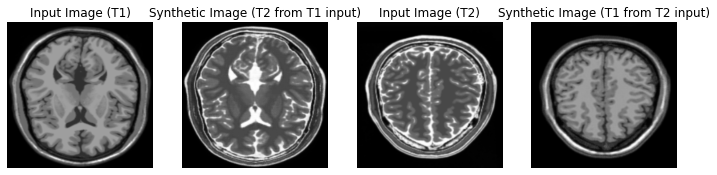

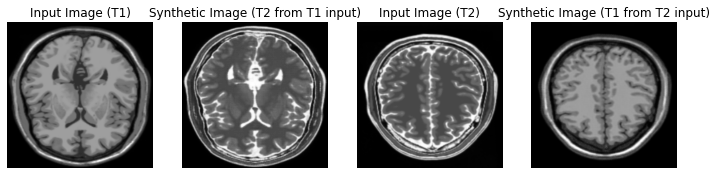

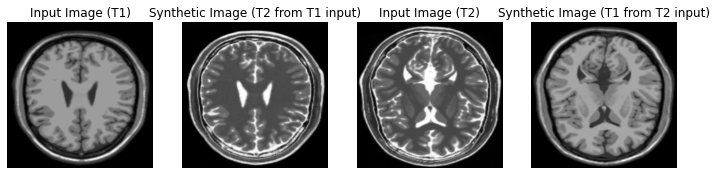

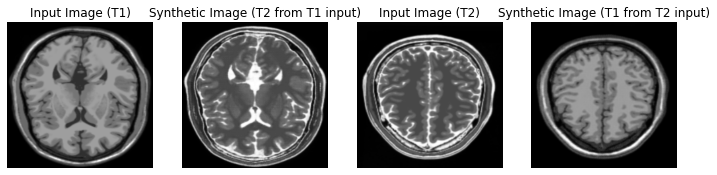

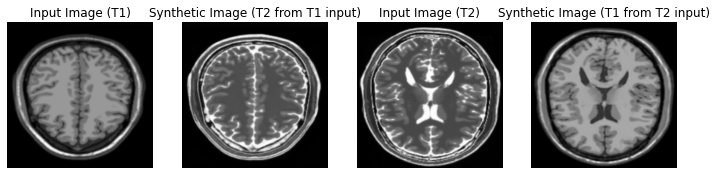

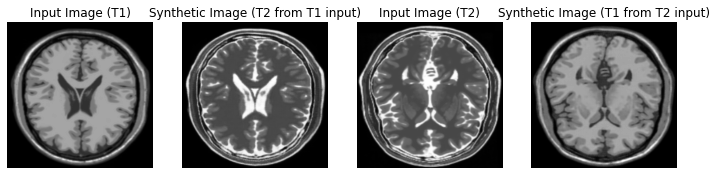

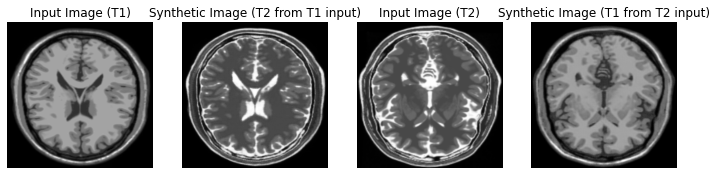

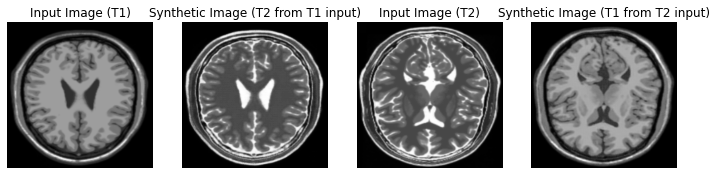

In [ ]:
# check the trained model on different images and check the output
import itertools
for (T1,T2) in itertools.zip_longest(T1.take(10), T2.take(10)):
  generate_images(generator_g, T1, generator_f, T2)

In [ ]:
# Finally creating an animation to see how the style transfer happened across all epochs for both T1 and T2

anim_file = 'animated_cycleGAN_%d_epochs.gif' % (EPOCHS) # animation image name (GIF format)

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

In [ ]:
# installing tensorflow docs
!pip install git+https://github.com/tensorflow/docs --quiet


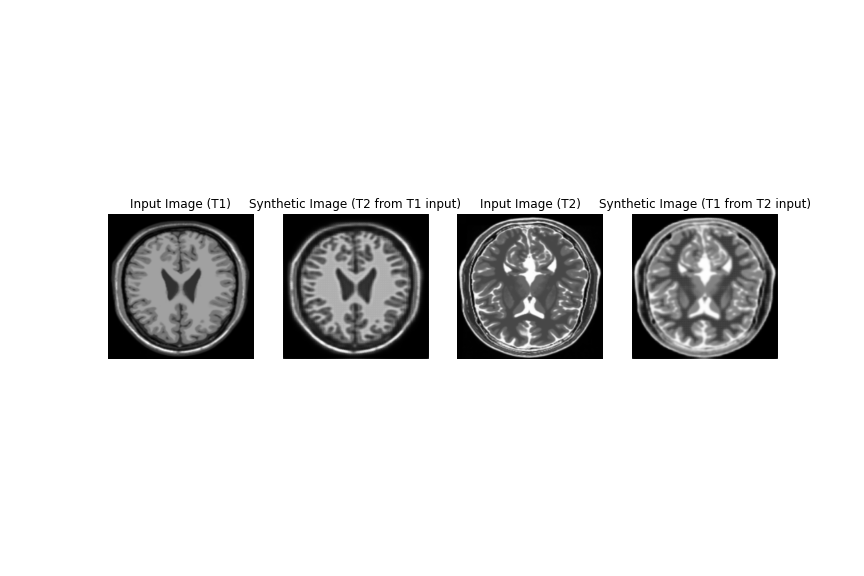

In [ ]:
# verifying the created animation fo trained images
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

## Testing the final model on a different data set

In [ ]:
# weighted T1 dataset
# !wget http://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T1.tar
# weighted T2 dataset
# !wget http://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T2.tar

--2022-03-07 19:47:19--  http://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T1.tar
Resolving biomedic.doc.ic.ac.uk (biomedic.doc.ic.ac.uk)... 146.169.22.31
Connecting to biomedic.doc.ic.ac.uk (biomedic.doc.ic.ac.uk)|146.169.22.31|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T1.tar [following]
--2022-03-07 19:47:20--  https://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T1.tar
Connecting to biomedic.doc.ic.ac.uk (biomedic.doc.ic.ac.uk)|146.169.22.31|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4840816640 (4.5G) [application/x-tar]
Saving to: ‘IXI-T1.tar’

IXI-T1.tar          100%[===================>]   4.51G  32.3MB/s    in 2m 22s  

2022-03-07 19:49:42 (32.5 MB/s) - ‘IXI-T1.tar’ saved [4840816640/4840816640]

URL transformed to HTTPS due to an HSTS policy
--2022-03-07 19:49:43--  https://biomedic.doc.ic.ac.uk/brain-devel